<a href="https://colab.research.google.com/github/thiagolermen/facemask-detection-v1/blob/main/PyTorch/FaceMaskDetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Imports

In [1]:
# Basic libraries
import os
import pathlib
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
# Data preprocessing
import PIL
import cv2
from skimage import io
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.utils.data import ConcatDataset
import torchvision.transforms as transforms
import torchvision
# Model
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

# Data visualization
from torch.utils.tensorboard import SummaryWriter

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


## Kaggle

In [3]:
os.environ['KAGGLE_CONFIG_DIR'] = "/content/gdrive/My Drive/Kaggle"
# /content/gdrive/My Drive/Kaggle is the path where kaggle.json is present in the Google Drive

In [4]:
#changing the working directory
%cd /content/gdrive/My Drive/Kaggle/
#Check the present working directory using pwd command

/content/gdrive/My Drive/Kaggle


In [5]:
!kaggle datasets download -d thiagolermen/dataset-face-mask-detection

 94% 120M/127M [00:00<00:00, 153MB/s]
100% 127M/127M [00:00<00:00, 164MB/s]


## Dataset

In [6]:
# Checking the file
!ls

CIFAR-10  dataset.csv			   kaggle.json	tests
dataset   dataset-face-mask-detection.zip  saved_model


In [7]:
#unzipping the zip files and deleting the zip files
!unzip \*.zip  && rm *.zip

Archive:  dataset-face-mask-detection.zip
replace dataset.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


In [84]:
class FaceMaskDataset(Dataset):
  def __init__(self, csv_file, root_dir, transform=None):
    self.annotations = pd.read_csv(csv_file)
    self.root_dir = root_dir
    self.transform = transform

  def __len__(self):
    return (len(self.annotations)) # 3824

  def __getitem__(self, index):
    img_path = self.annotations.iloc[index, 0]
    image = np.array(PIL.Image.open(img_path).convert('RGB'))
    y_label = torch.tensor(int(self.annotations.iloc[index, 1]))

    if self.transform is not None:
      image = self.transform(image)

    return (image, y_label)

## Data preprocessing

### Augmentation

In [85]:
my_transforms = transforms.Compose([
  transforms.ToPILImage(),
  transforms.Resize((224,224)),
  transforms.RandomCrop((224,224)),
  transforms.ColorJitter(brightness=0.5),
  transforms.RandomRotation(degrees=45),
  transforms.RandomHorizontalFlip(p=0.5),
  transforms.RandomVerticalFlip(p=0.05),
  transforms.RandomGrayscale(p=0.2),
  transforms.ToTensor(),
  transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]) # (value - mean) / std
  ])

### Create dataset

In [86]:
batch_size = 32
dataset = FaceMaskDataset(csv_file = '/content/gdrive/My Drive/Kaggle/dataset/dataset.csv', root_dir='/content/gdrive/My Drive/Kaggle/dataset/', transform=my_transforms)
print(f'Dataset length: {len(dataset)}')
train_ds, test_ds = torch.utils.data.random_split(dataset, [int((0.8*len(dataset))), int((0.2*len(dataset))+1)])
print(f'train_ds length: {len(train_ds)}')
print(f'test_ds length: {len(test_ds)}')
train_dl = DataLoader(dataset=train_ds, batch_size=batch_size, shuffle=True)
test_dl = DataLoader(dataset=test_ds, batch_size=batch_size, shuffle=True)

Dataset length: 3824
train_ds length: 3059
test_ds length: 765


In [87]:
train_dl, test_dl

(<torch.utils.data.dataloader.DataLoader at 0x7f40b62ac0d0>,
 <torch.utils.data.dataloader.DataLoader at 0x7f3ff90efa50>)

In [88]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.figure(figsize = (15 , 15))
    plt.imshow(inp)
    #if title is not None:
        #plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

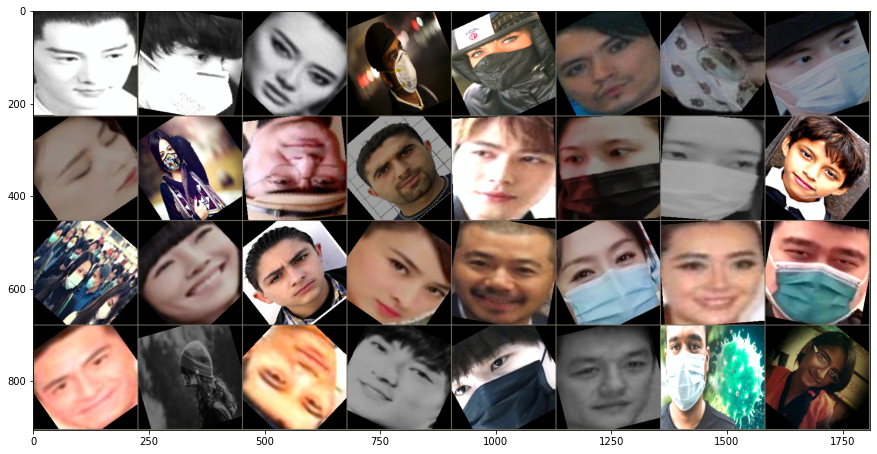

In [89]:
class_names = ['with_mask', 'without_mask']
# Get a batch of training data
inputs, classes = next(iter(train_dl))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

imshow(out, title=[class_names[x] for x in classes])

## Model

In [102]:
model = torch.hub.load('pytorch/vision:v0.6.0', 'mobilenet_v2', pretrained=True)
#freezing the initial layers of MobileNetv2
for param in model.parameters():
    param.requires_grad = False
#adding our own classifier
model.classifier[1] = nn.Sequential(
                      nn.Linear(1280, 256),
                      nn.ReLU(),
                      nn.Linear(256, 128),
                      nn.ReLU(), 
                      nn.Dropout(0.4),
                      nn.Linear(128, 64),
                      nn.ReLU(),
                      nn.Linear(64, 32),
                      nn.ReLU(),
                      nn.Dropout(0.4),
                      nn.Linear(32, 2), 
                      nn.LogSoftmax(dim=1))

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.6.0


In [103]:
#checking trainable parameters
print(sum(p.numel() for p in model.parameters() if p.requires_grad))

371234


In [104]:
#checking GPU Avaibility
if torch.cuda.is_available():
    print('training on GPU')
    device = torch.device("cuda:0")
else:
    print('training on CPU')
    device = torch.device("cpu")

training on GPU


## Train and test

Training function

In [128]:
#training data
from tqdm.notebook import tqdm #for loading bars

def train(model, optimizer, loss_fn, train_loader, val_loader, epochs,device):
    writer = SummaryWriter("dataset/saves/logs")
    for epoch in tqdm(range(epochs)):
        training_loss = 0.0
        valid_loss = 0.0
        model.train()
        for inputs, targets in train_loader:
            optimizer.zero_grad()
            inputs = inputs.to(device)
            targets = targets.to(device)
            output = model(inputs)
            loss = loss_fn(output, targets)
            loss.backward()
            optimizer.step()
            training_loss += loss.data.item() * inputs.size(0)
        training_loss /= len(train_loader.dataset)
        
        model.eval()
        num_correct = 0 
        num_examples = 0
        for inputs, targets in val_loader:
            inputs = inputs.to(device)
            output = model(inputs)
            targets = targets.to(device)
            loss = loss_fn(output,targets) 
            valid_loss += loss.data.item() * inputs.size(0)          
            correct = torch.eq(torch.max(F.softmax(output, dim=1), dim=1)[1], targets).view(-1)
            num_correct += torch.sum(correct).item()
            num_examples += correct.shape[0]
        valid_loss /= len(val_loader.dataset)

        print('Epoch: {}, Training Loss: {:.4f}, Validation Loss: {:.4f}, accuracy = {:.4f}'.format(epoch, training_loss,valid_loss, num_correct / num_examples))
        
        #save model
        if(training_loss<0.005):
            torch.save(model,"dataset/saves/"+str(epoch)+".pth")
        
        #tensorBoard save log
        writer.add_scalar('Loss', loss.item(), epoch)
        writer.add_scalar('Train/Loss', training_loss, epoch)
        writer.add_scalar('Test/Loss', valid_loss, epoch)
        writer.add_scalar('Test/Accuracy',num_correct / num_examples, epoch)
        writer.flush()

Testing function

In [129]:
#testing data
def test_model(model):
    correct = 0
    total = 0
    with torch.no_grad():
        for data in test_dl:
            images, labels = data[0].to(device), data[1].to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    print('correct: {:d}  total: {:d}'.format(correct, total))
    print('accuracy = {:f}'.format(correct / total))

Put model to device

In [132]:
#put model to GPU (if available)
model = model.to(device)

Set the optimizer and loss function

In [133]:
#choosing optimizer and loss Function
optimizer = optim.Adam(model.parameters(), lr=0.001)
loss = nn.CrossEntropyLoss()

Fit the model

In [134]:
#train the model first 50 epochs
train(model, optimizer, loss, train_dl, test_dl, 50, device)

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


Epoch: 0, Training Loss: 0.0902, Validation Loss: 0.0726, accuracy = 0.9725
Epoch: 1, Training Loss: 0.0822, Validation Loss: 0.0994, accuracy = 0.9686
Epoch: 2, Training Loss: 0.0860, Validation Loss: 0.0735, accuracy = 0.9725
Epoch: 3, Training Loss: 0.0792, Validation Loss: 0.0730, accuracy = 0.9739
Epoch: 4, Training Loss: 0.0829, Validation Loss: 0.0646, accuracy = 0.9739
Epoch: 5, Training Loss: 0.1022, Validation Loss: 0.0874, accuracy = 0.9739
Epoch: 6, Training Loss: 0.0700, Validation Loss: 0.1209, accuracy = 0.9712
Epoch: 7, Training Loss: 0.0842, Validation Loss: 0.0598, accuracy = 0.9765
Epoch: 8, Training Loss: 0.0830, Validation Loss: 0.0928, accuracy = 0.9712
Epoch: 9, Training Loss: 0.0818, Validation Loss: 0.0767, accuracy = 0.9725
Epoch: 10, Training Loss: 0.0826, Validation Loss: 0.0606, accuracy = 0.9843
Epoch: 11, Training Loss: 0.0952, Validation Loss: 0.0666, accuracy = 0.9778
Epoch: 12, Training Loss: 0.0773, Validation Loss: 0.0609, accuracy = 0.9725
Epoch: 13

In [142]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [144]:
%tensorboard --logdir dataset/saves/logs/

<IPython.core.display.Javascript object>

Evaluate the model

In [145]:
#test the model
test_model(model)

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


correct: 747  total: 765
accuracy = 0.976471


Save the model

In [148]:
# Save the first 50 epochs as a firstFifty.
!mkdir -p dataset/saved_model
torch.save(model, "dataset/saved_model/firstFifty.pth")

## Face mask detection

Load the model

In [ ]:
my_model = torch.load("dataset/saved_model/firstFifty.pth")

In [205]:
def predict_image(img, model):
    # Convert to a batch of 1
    xb = img.unsqueeze(0).to(device)
    # Get predictions from model
    yb = model(xb)
    print(yb)
    # Pick index with highest probability
    _, preds  = torch.max(yb, dim=1)
    # Retrieve the class label
    return preds

In [199]:
def face_detection(path):
  image = cv2.imread(path)
  faceCascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
  image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  faces = faceCascade.detectMultiScale(image_gray, scaleFactor=1.03, minNeighbors=4)
  for x,y,w,h in faces:
    only_face_gray = image_gray[y:y+h, x:x+w]
    only_face = image[y:y+h, x:x+w]
    cv2.rectangle(image, (x,y), (x+w, y+h), (0,255,255), 2)
    facess = faceCascade.detectMultiScale(only_face_gray)
    if len(facess) == 0:
      print("Face not detected!")
    else:
      for (ex,ey,ew,eh) in facess:
        cropped_face = only_face[ey:ey+eh, ex:ex+ew]

      final_image = my_transforms(cropped_face)
      

      cropped_face = cv2.resize(cropped_face, (224,224))

      font = cv2.FONT_HERSHEY_PLAIN # font to put text on the image

      prediction = predict_image(final_image, model)
      print(prediction)
      if prediction == 0:
        print(f"With mask")
        text = f"mask"
        cv2.putText(cropped_face, text, (10,200), font, 1, (0, 255, 0), 1, cv2.LINE_AA)
        cv2.rectangle(image, (x,y), (x+w, y+h), (0,255,0), 2)
      else:
        print(f"Without mask")
        text = f"no mask"
        cv2.putText(cropped_face, text, (10,200), font, 1, (0, 0, 255), 1, cv2.LINE_AA)
        cv2.rectangle(image, (x,y), (x+w, y+h), (0,0,255), 2)
            
      # Plot two images
      plt.figure(figsize = (10,10))

      plt.subplot(1,2,1)
      plt.title('Full image')
      plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

      plt.subplot(1,2,2)
      plt.title('face_only')
      plt.imshow(cv2.cvtColor(cropped_face, cv2.COLOR_BGR2RGB))

Face not detected!
tensor([[-0.0370, -3.3146]], device='cuda:0', grad_fn=<LogSoftmaxBackward>)
tensor([0], device='cuda:0')
With mask
tensor([[-0.0115, -4.4700]], device='cuda:0', grad_fn=<LogSoftmaxBackward>)
tensor([0], device='cuda:0')
With mask
Face not detected!
Face not detected!
Face not detected!


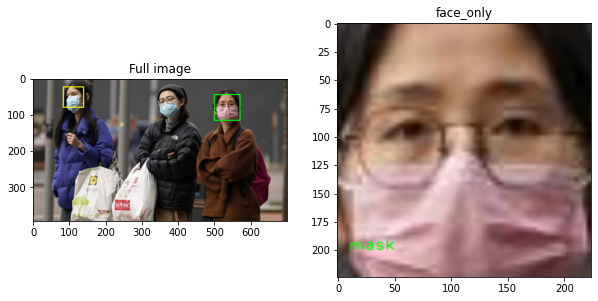

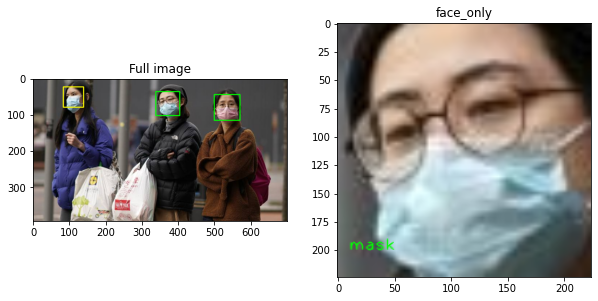

In [206]:
face_detection('/content/gdrive/My Drive/Kaggle/dataset/test1.jpg')

tensor([0], device='cuda:0')
With mask
Face not detected!
Face not detected!
Face not detected!
Face not detected!


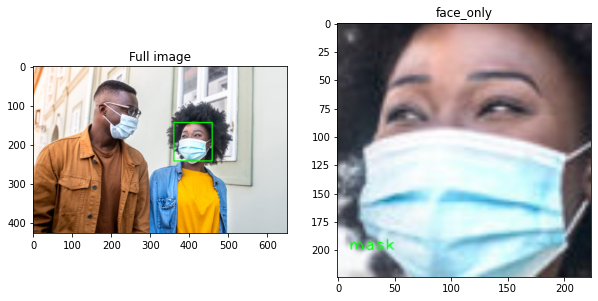

In [201]:
face_detection('/content/gdrive/My Drive/Kaggle/dataset/test2.jpg')

Face not detected!
tensor([0], device='cuda:0')
With mask
tensor([0], device='cuda:0')
With mask
tensor([0], device='cuda:0')
With mask
Face not detected!


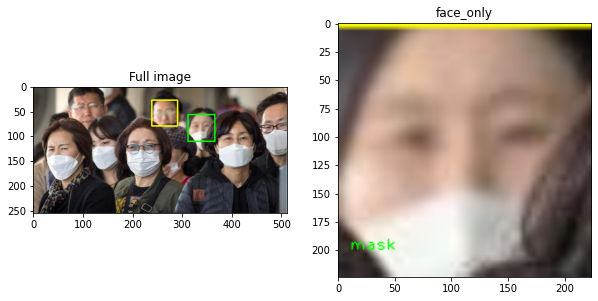

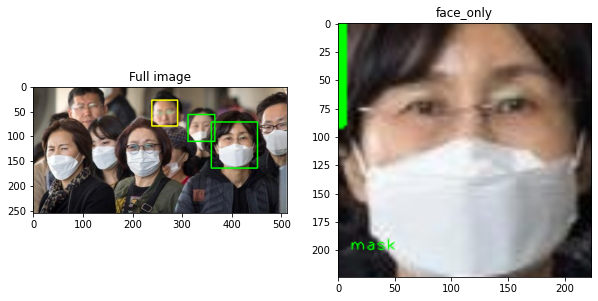

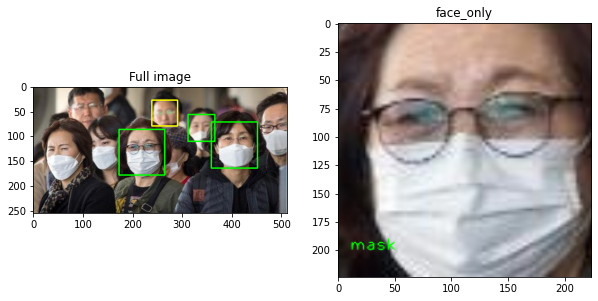

In [202]:
face_detection('/content/gdrive/My Drive/Kaggle/dataset/test3.jpg')

Face not detected!
Face not detected!
tensor([1], device='cuda:0')
Without mask
Face not detected!
tensor([0], device='cuda:0')
With mask
Face not detected!
Face not detected!
Face not detected!


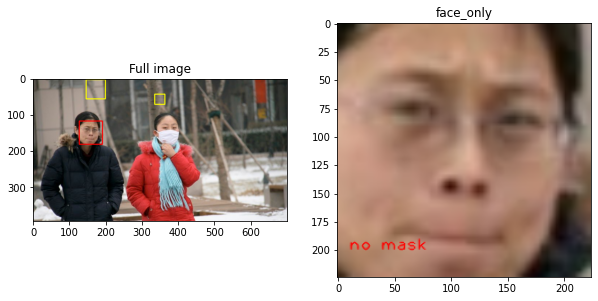

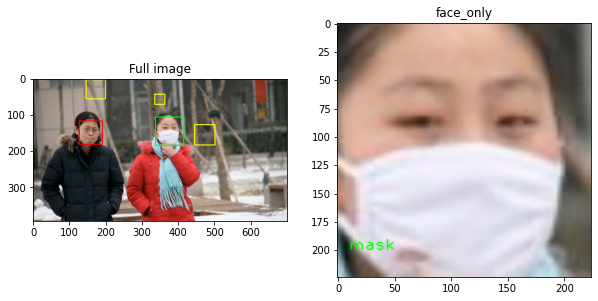

In [203]:
face_detection('/content/gdrive/My Drive/Kaggle/dataset/test4.jpg')

tensor([0], device='cuda:0')
With mask
tensor([0], device='cuda:0')
With mask
Face not detected!
Face not detected!
Face not detected!
Face not detected!
Face not detected!


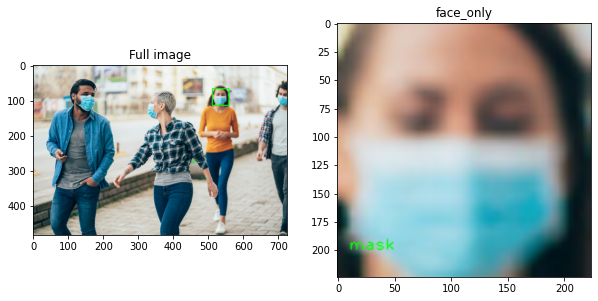

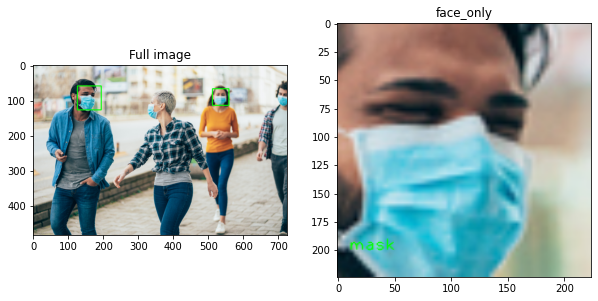

In [204]:
face_detection('/content/gdrive/My Drive/Kaggle/dataset/test5.jpg')